In [1]:
import pandas as pd
import numpy as np

data = pd.read_csv('../data/backtest_data_after_regime_prediction.csv')
data['Date'] = pd.to_datetime(data['Date'])
data.set_index('Date', inplace=True)

## Add bollinger bands

In [2]:
# create a moving average
data['ema_20'] = data['Close'].ewm(span=20, adjust=False).mean()

# add a 10-day EMA
data['ema_10'] = data['Close'].ewm(span=10, adjust=False).mean()


In [3]:
# add bollinger bands 1SD from ema_20

# Calculate the standard deviation over the same span
data['stddev_20'] = data['Close'].ewm(span=20, adjust=False).std()

# Calculate the upper Bollinger Band 1SD
data['upper_band_1sd'] = data['ema_20'] + (data['stddev_20'] * 1)

# Calculate the lower Bollinger Band 1SD
data['lower_band_1sd'] = data['ema_20'] - (data['stddev_20'] * 1)

# Calculate the upper Bollinger Band 1.5SD
data['upper_band_1.5sd'] = data['ema_20'] + (data['stddev_20'] * 1.5)

# Calculate the lower Bollinger Band 1.5SD
data['lower_band_1.5sd'] = data['ema_20'] - (data['stddev_20'] * 1.5)

# Calculate the upper Bollinger Band 2SD
data['upper_band_2sd'] = data['ema_20'] + (data['stddev_20'] * 2)

# Calculate the lower Bollinger Band 2SD
data['lower_band_2sd'] = data['ema_20'] - (data['stddev_20'] * 2)

## Add fibonacci levels

In [4]:
# Create new columns for Fibonacci levels
data['fib_level_0.236'] = np.nan
data['fib_level_0.382'] = np.nan
data['fib_level_0.5'] = np.nan  # Added 0.5 level
data['fib_level_0.618'] = np.nan

# Calculate Fibonacci levels for each day
for i in range(251, len(data)):
    window = data.iloc[i-251:i+1]
    low = window['Low'].min()
    high = window['High'].max()
    diff = high - low
    data.loc[data.index[i], 'fib_level_0.236'] = high - 0.236 * diff
    data.loc[data.index[i], 'fib_level_0.382'] = high - 0.382 * diff
    data.loc[data.index[i], 'fib_level_0.5'] = high - 0.5 * diff  # Calculate 0.5 level
    data.loc[data.index[i], 'fib_level_0.618'] = high - 0.618 * diff

## Add MACD

In [5]:
# Define the short and long lookback periods
short_period = 12 #12 day ema
long_period = 26 #26 day ema

# Calculate the short and long period exponential moving averages
data['short_ema'] = data['Close'].ewm(span=short_period, adjust=False).mean()
data['long_ema'] = data['Close'].ewm(span=long_period, adjust=False).mean()

# Calculate the MACD line
data['MACD_line'] = data['short_ema'] - data['long_ema']

# Calculate the signal line
signal_period = 9
data['signal_line'] = data['MACD_line'].ewm(span=signal_period, adjust=False).mean()

# Calculate the MACD histogram
data['MACD_histogram'] = data['MACD_line'] - data['signal_line']

## Add RSI

In [6]:
# Define the lookback period
lookback_period = 14

# Calculate the difference in price
delta = data['Close'].diff()

# Separate positive and negative differences
up, down = delta.copy(), delta.copy()
up[up < 0] = 0
down[down > 0] = 0

# Calculate the average gain and average loss
avg_gain = up.ewm(com=lookback_period-1, min_periods=lookback_period).mean()
avg_loss = abs(down.ewm(com=lookback_period-1, min_periods=lookback_period).mean())

# Calculate RS
RS = avg_gain / avg_loss

# Calculate the RSI
data['RSI'] = 100 - (100 / (1 + RS))

In [7]:
data.tail()

,regime,Volume,Open,High,Low,Close,ema_20,ema_10,stddev_20,upper_band_1sd,...,fib_level_0.236,fib_level_0.382,fib_level_0.5,fib_level_0.618,short_ema,long_ema,MACD_line,signal_line,MACD_histogram,RSI
Date,,,,,,,,,,,,,,,,,,,,,
2024-03-01,blue,4748110000,5098.51,5140.33,5094.16,5137.08,5020.372353,5067.778869,99.135149,5119.507501,...,4826.10308,4631.70846,4474.595,4317.48154,5057.907372,4993.257677,64.649695,62.203764,2.445931,70.387006
2024-03-04,blue,4758440000,5130.99,5149.67,5127.18,5130.95,5030.903557,5079.264529,100.004308,5130.907865,...,4833.23884,4637.48058,4479.265,4321.04942,5069.144699,5003.457108,65.687591,62.900530,2.787061,69.220177
2024-03-05,blue,4418410000,5110.52,5114.54,5056.82,5078.65,5035.450837,5079.152796,96.203826,5131.654663,...,4833.23884,4637.48058,4479.265,4321.04942,5070.607053,5009.026952,61.580101,62.636444,-1.056343,60.070573
2024-03-06,blue,4559050000,5108.03,5127.97,5092.22,5104.76,5042.051710,5083.808652,93.858649,5135.910359,...,4833.23884,4637.48058,4479.265,4321.04942,5075.861353,5016.118289,59.743064,62.057768,-2.314704,62.719905
2024-03-07,blue,4137980000,5132.38,5165.62,5128.21,5157.36,5053.033452,5097.181624,95.793725,5148.827177,...,4845.42464,4647.33768,4487.240,4327.14232,5088.399606,5026.580638,61.818968,62.010008,-0.191040,67.411036


## Export file

In [8]:
data.to_csv('../data/backtest_data_with_technical_indicators.csv')

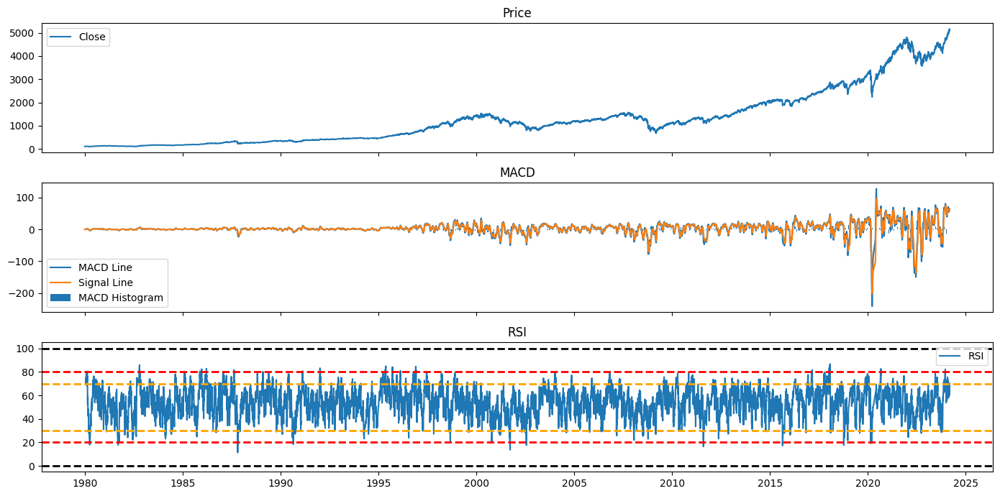

In [9]:
import matplotlib.pyplot as plt

# Create subplots
fig, (ax1, ax2, ax3) = plt.subplots(3, sharex=True, figsize=(14, 7))

# Plot price
ax1.plot(data.index, data['Close'], label='Close')
ax1.set_title('Price')
ax1.legend()

# Plot MACD
ax2.plot(data.index, data['MACD_line'], label='MACD Line')
ax2.plot(data.index, data['signal_line'], label='Signal Line')
ax2.bar(data.index, data['MACD_histogram'], label='MACD Histogram')
ax2.set_title('MACD')
ax2.legend()

# Plot RSI
ax3.plot(data.index, data['RSI'], label='RSI')
ax3.axhline(0, color='black', linewidth=2, linestyle='--')
ax3.axhline(20, color='red', linewidth=2, linestyle='--')
ax3.axhline(30, color='orange', linewidth=2, linestyle='--')
ax3.axhline(70, color='orange', linewidth=2, linestyle='--')
ax3.axhline(80, color='red', linewidth=2, linestyle='--')
ax3.axhline(100, color='black', linewidth=2, linestyle='--')
ax3.set_title('RSI')
ax3.legend()

# Show the plot
plt.tight_layout()
plt.show()

## Price trends for Bollinger Band Indicator

/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_52248/2291898997.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_52248/2291898997.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'].iloc[0] = 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_52248/2291898997.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_inde

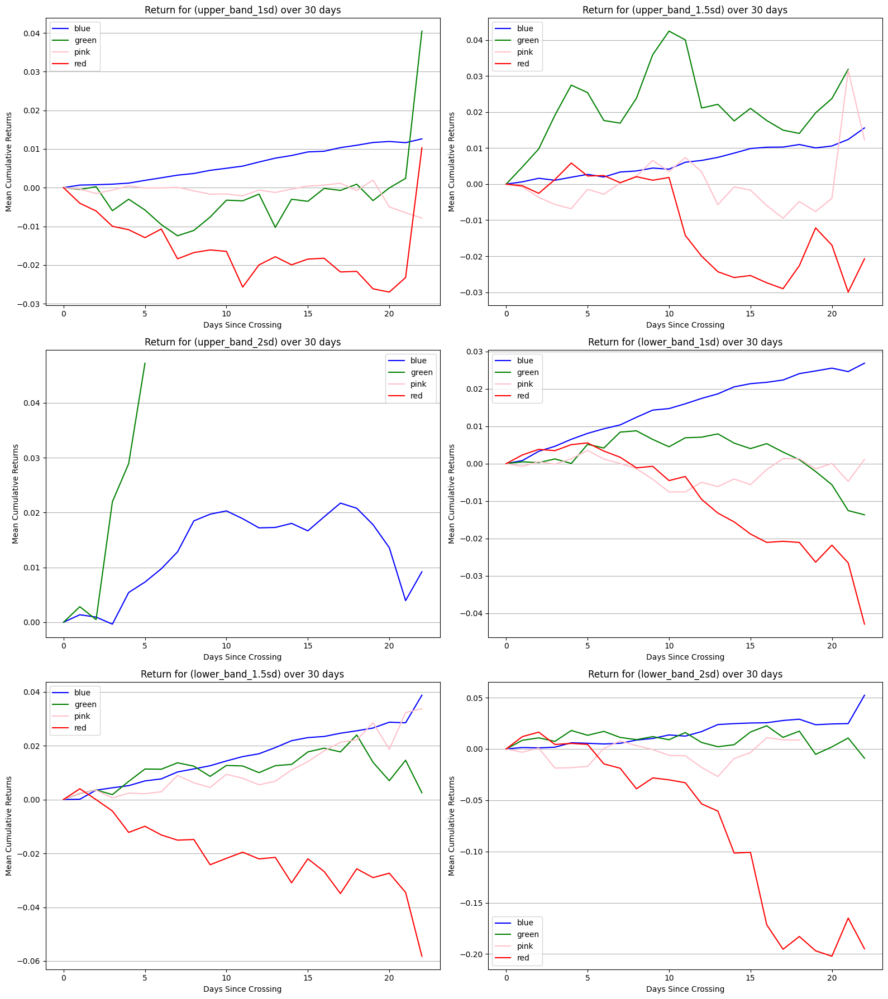

In [10]:
import matplotlib.pyplot as plt

regimes = ['blue', 'green', 'pink', 'red']
bands = ['upper_band_1sd', 'upper_band_1.5sd', 'upper_band_2sd', 'lower_band_1sd', 'lower_band_1.5sd', 'lower_band_2sd']
rows = len(bands)//2+len(bands)%2
mean_returns = {band: {} for band in bands}

for band in bands:
    if 'upper' in band:
        data[f'cross_{band}'] = (data['Close'] > data[band]) & (data['Close'].shift(1) < data[band].shift(1))
    else:
        data[f'cross_{band}'] = (data['Close'] < data[band]) & (data['Close'].shift(1) > data[band].shift(1))
    crossings = data[data[f'cross_{band}']]

    for regime in regimes:
        returns = []

        for date in crossings.index:
            next_30_days = data.loc[date:date + pd.Timedelta(days=30)]
            
            next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
            next_30_days['returns'].iloc[0] = 1
            next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1

            current_regime = next_30_days['regime'].iloc[0]
            
            if current_regime == regime:
                daily_returns = []
                for next_date, row in next_30_days.iterrows():
                    if row['regime'] != regime:
                        break
                    daily_returns.append(row['cumulative_returns'])
                returns.append(daily_returns)

        if returns:
            max_length = max(len(r) for r in returns)
            returns_padded = [r + [np.nan]*(max_length - len(r)) for r in returns]
        else:
            returns_padded = []

        returns_array = np.array(returns_padded)
        mean_returns[band][regime] = np.nanmean(returns_array, axis=0)

fig, axs = plt.subplots(rows, 2, figsize=(16, 18))

# Flatten the axes array for easy iteration
axs = axs.flatten()

for ax, band in zip(axs, bands):
    for regime, returns in mean_returns[band].items():
        if isinstance(returns, np.ndarray):
            ax.plot(range(len(returns)), returns, color=regime, label=regime)
        else:
            ax.plot(0, returns, color=regime, label=regime)
    ax.set_title(f'Return for ({band}) over 30 days')
    ax.set_xlabel('Days Since Crossing')
    ax.set_ylabel('Mean Cumulative Returns')
    ax.legend()
    ax.grid(axis='y')  # Add horizontal grid lines

plt.tight_layout()
plt.show()

finding the returns from bollinger band strategy if constrained to only one trade at a time (accounting for regime)

In [11]:
bands = ['upper_band_1sd', 'upper_band_1.5sd', 'upper_band_2sd', 'lower_band_1sd', 'lower_band_2sd', 'lower_band_1.5sd']
regimes = ['blue', 'green', 'pink', 'red']

result = {}
regime_count = {}
for band in bands:
    regime_count[band] = {}
    result[band] = {}
    for regime in regimes:
        result[band][regime] = {}
        regime_count[band][regime] = {}
        for i in range(1, 31):
            regime_count[band][regime][i] = 0
            result[band][regime][i] = 0
    hold = 1
    enter = hold
    current = 0
    entered = False
    timeframe = 0
    trades = 0
    current_regime = ""

    for index, row in data.iterrows():
        if not entered:
            if row[f'cross_{band}']:
                entered = True
                enter = row['Close']
                current_regime = row['regime']
        if entered:
            timeframe += 1
            if timeframe == 30 or row['regime'] != current_regime:
                result[band][current_regime][timeframe] += ((row['Close'] / enter) - 1)
                regime_count[band][current_regime][timeframe] += 1
                timeframe = 0
                entered = False
            else:
                result[band][current_regime][timeframe] += ((row['Close'] / enter) - 1)
                regime_count[band][current_regime][timeframe] += 1

for band in bands:
    for regime in regimes:
        for i in result[band][regime]:
            if regime_count[band][regime][i] > 0:
                result[band][regime][i] /= regime_count[band][regime][i]


print(result)
# print(result['upper_band_1sd']['red'])
# print(result['upper_band_1sd'])


{'upper_band_1sd': {'blue': {1: 0.0, 2: 0.000801830828962362, 3: 0.000644749330618177, 4: 0.0005210241822420485, 5: 0.0010850158464660786, 6: 0.0015112564312868126, 7: 0.002167756023177789, 8: 0.0030945074954877015, 9: 0.0031251072877544867, 10: 0.0046354123984100725, 11: 0.005823996687671226, 12: 0.006527807144480455, 13: 0.007413792900441075, 14: 0.007387264090371867, 15: 0.008315652396499135, 16: 0.00965278547039379, 17: 0.011068397445678413, 18: 0.011665054902444119, 19: 0.01203545448604211, 20: 0.012814095373387263, 21: 0.014331925943936995, 22: 0.014595501898155385, 23: 0.014445475128630685, 24: 0.015608977729318954, 25: 0.016983380589101652, 26: 0.01669153218388618, 27: 0.016627601066036706, 28: 0.017417669870489483, 29: 0.018805633361494805, 30: 0.01905309843826248}, 'green': {1: 0.0, 2: -0.0010970585867171123, 3: 0.001470653178818598, 4: -0.005461881466066608, 5: -0.00348831325572585, 6: 0.003080500549149473, 7: -0.0029662112106712754, 8: -0.005388060233865614, 9: -0.006797266

creating the dataframe for returns from bollinger band strategy

In [12]:
band_df = {band: pd.DataFrame(result[band]) for band in result}

band_df['upper_band_1sd'].tail()


,blue,green,pink,red
26,0.016692,0.020629,0.009154,-0.020668
27,0.016628,0.021621,0.009519,-0.022373
28,0.017418,0.015143,0.007598,-0.017274
29,0.018806,0.012196,0.007914,-0.015222
30,0.019053,-0.002950,0.009859,-0.021516


In [13]:
# bands = ['upper_band_1sd', 'upper_band_1.5sd', 'upper_band_2sd', 'lower_band_1sd', 'lower_band_2sd', 'lower_band_1.5sd']
print(trades)

# result = {}
# for band in bands:
#     result[band] = {}
#     hold = 1
#     enter = hold
#     current = 0
#     entered = False
#     timeframe = 0
#     for index, row in data.iterrows():
#         if not entered:
#             if row[f'cross_upper_{band}']:
#                 timeframe += 1
#                 # print(f'entering at {row["Close"]}')
#                 entered = True
#                 enter = row["Close"]
#         if entered:
#             timeframe += 1
#             current = row["Close"]
#             if row[f'cross_lower_{band}']:
#                 # print(f'exiting at {row["Close"]}')
#                 entered = False
#                 hold *= (row["Close"] / enter)
#                 result[band][timeframe] = (row['Close'] / enter)
#                 timeframe = 0

#     if entered:
#         hold *= (current / enter)
#     result[band]["total"] = hold

# print(result)

0


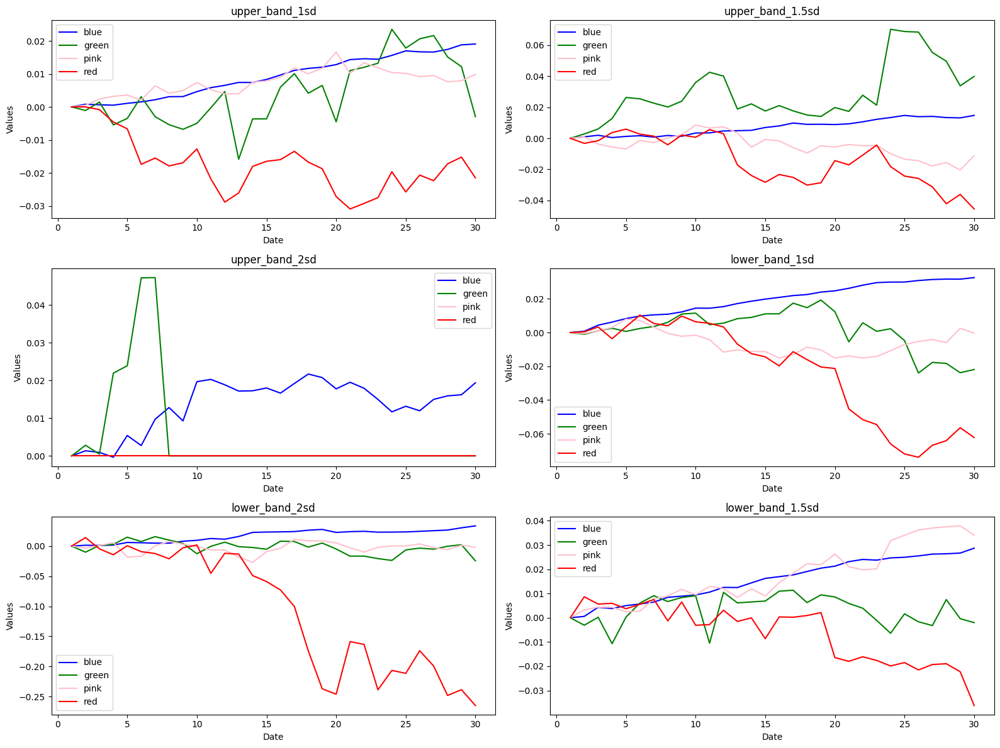

In [14]:
num_plots = len(band_df)
num_rows = num_plots // 2 + num_plots % 2
num_cols = 2

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(16, 12))


# Plot each pair of DataFrames
for i, (key, df) in enumerate(band_df.items()):
    row = i // 2
    col = i % 2
    ax = axs[row, col] if num_rows > 1 else axs[col]
    
    # Plot each column except the datetime index
    for column in df.columns:
        ax.plot(df.index, df[column], color = column, label=column)
    
    ax.set_title(key)
    ax.set_xlabel('Date')
    ax.set_ylabel('Values')
    ax.legend()

# Adjust layout and display
plt.tight_layout()
plt.show()

In [15]:
# crossings.tail()
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 10657 entries, 1979-12-26 to 2024-03-07
Data columns (total 31 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   regime                  10657 non-null  object 
 1   Volume                  10657 non-null  int64  
 2   Open                    10657 non-null  float64
 3   High                    10657 non-null  float64
 4   Low                     10657 non-null  float64
 5   Close                   10657 non-null  float64
 6   ema_20                  10657 non-null  float64
 7   ema_10                  10657 non-null  float64
 8   stddev_20               10656 non-null  float64
 9   upper_band_1sd          10656 non-null  float64
 10  lower_band_1sd          10656 non-null  float64
 11  upper_band_1.5sd        10656 non-null  float64
 12  lower_band_1.5sd        10656 non-null  float64
 13  upper_band_2sd          10656 non-null  float64
 14  lower_band_2sd       

Upper band crossover 1SD - SHORT Bearish high var  
Upper band crossover 1.5SD - LONG Bullish high var SHORT Bearish high var  
Upper band crossover 2SD - LONG Bullish low and high var  
Lower band crossover 1SD - SHORT Bearish high var LONG Bullish low var  
Lower band crossover 1.5SD - Short Bearish high var LONG Bearish and Bullish low var  
Lower band crossover 2SD - Short Bearish High var LONG Bullish low var  

LONG Bearish high var -  
LONG Bearish low var - Lower band crossover 1.5SD  
LONG Bullish high var -  Upper band crossover 1.5SD, Upper band Crossover 2SD  
LONG Bullish low var - Lower band crossover 1SD, , Lower band crossover 1.5SD, Lower band crossover 2SD, Upper band crossover 2SD  
SHORT Bearish low var -  
SHORT Bearish high var - Lower band crossover 1SD, Lower band crossover 1.5SD, Lower band crossover 2SD, Upper band crossover 1SD, Upper band crossover 1.5SD  
SHORT Bullish low var -   
SHORT Bullish high var -  


## Price trends for fibonacci levels

/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_52248/717325035.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_52248/717325035.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'].iloc[0] = 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_52248/717325035.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer

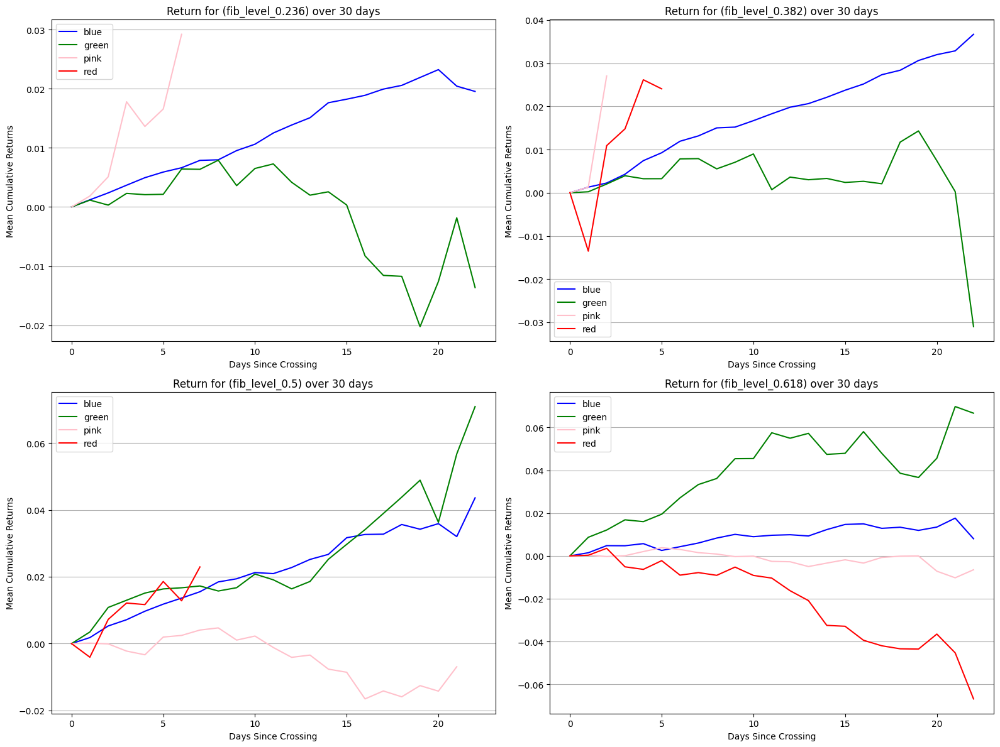

In [16]:
import matplotlib.pyplot as plt

regimes = ['blue', 'green', 'pink', 'red']
fib_levels = ['fib_level_0.236', 'fib_level_0.382', 'fib_level_0.5','fib_level_0.618']
rows = len(fib_levels)//2+len(fib_levels)%2
mean_returns = {level: {} for level in fib_levels}

for level in fib_levels:
    data[f'cross_{level}'] = (data['Close'] < data[level]) & (data['Close'].shift(1) > data[level].shift(1))  # Change here
    crossings = data[data[f'cross_{level}']]

    for regime in regimes:
        returns = []

        for date in crossings.index:
            next_30_days = data.loc[date:date + pd.Timedelta(days=30)]
            
            next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
            next_30_days['returns'].iloc[0] = 1
            next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1

            current_regime = next_30_days['regime'].iloc[0]
            
            if current_regime == regime:
                daily_returns = []
                for next_date, row in next_30_days.iterrows():
                    if row['regime'] != regime:
                        break
                    daily_returns.append(row['cumulative_returns'])
                returns.append(daily_returns)

        if returns:
            max_length = max(len(r) for r in returns)
            returns_padded = [r + [np.nan]*(max_length - len(r)) for r in returns]
        else:
            returns_padded = []

        returns_array = np.array(returns_padded)
        mean_returns[level][regime] = np.nanmean(returns_array, axis=0)

fig, axs = plt.subplots(rows, 2, figsize=(16, 12))

# Flatten the axes array for easy iteration
axs = axs.flatten()

for ax, level in zip(axs, fib_levels):
    for regime, returns in mean_returns[level].items():
        if isinstance(returns, np.ndarray):
            ax.plot(range(len(returns)), returns, color=regime, label=regime)
        else:
            ax.plot(0, returns, color=regime, label=regime)
    ax.set_title(f'Return for ({level}) over 30 days')
    ax.set_xlabel('Days Since Crossing')
    ax.set_ylabel('Mean Cumulative Returns')
    ax.legend()
    ax.grid(axis='y')

plt.tight_layout()
plt.show()

In [17]:
fibs = ['fib_level_0.236', 'fib_level_0.382', 'fib_level_0.5', 'fib_level_0.618']
regimes = ['blue', 'green', 'pink', 'red']

result = {}
regime_count = {}
for fib in fibs:
    regime_count[fib] = {}
    result[fib] = {}
    for regime in regimes:
        result[fib][regime] = {}
        regime_count[fib][regime] = {}
        for i in range(1, 31):
            regime_count[fib][regime][i] = 0
            result[fib][regime][i] = 0
    hold = 1
    enter = hold
    current = 0
    entered = False
    timeframe = 0
    trades = 0
    current_regime = ""

    for index, row in data.iterrows():
        if not entered:
            if row[f'cross_{fib}']:
                entered = True
                enter = row['Close']
                current_regime = row['regime']
        if entered:
            timeframe += 1
            if timeframe == 30 or row['regime'] != current_regime:
                result[fib][current_regime][timeframe] += ((row['Close'] / enter) - 1)
                regime_count[fib][current_regime][timeframe] += 1
                timeframe = 0
                entered = False
            else:
                result[fib][current_regime][timeframe] += ((row['Close'] / enter) - 1)
                regime_count[fib][current_regime][timeframe] += 1

for fib in fibs:
    for regime in regimes:
        for i in result[fib][regime]:
            if regime_count[fib][regime][i] > 0:
                result[fib][regime][i] /= regime_count[fib][regime][i]


print(result)

{'fib_level_0.236': {'blue': {1: 0.0, 2: 0.0011315155334656196, 3: 0.0034090994809770703, 4: 0.004804953147847983, 5: 0.004823442236218619, 6: 0.0075347854110962885, 7: 0.008776304403472124, 8: 0.01034567972081162, 9: 0.011204495192544257, 10: 0.011922755352742018, 11: 0.014077122607586005, 12: 0.015272322961733285, 13: 0.016469113911082613, 14: 0.01859383601282577, 15: 0.020310324812959434, 16: 0.0211437062242698, 17: 0.021611876960132774, 18: 0.02163464093255328, 19: 0.022206465674175356, 20: 0.024356258171366777, 21: 0.02431816735387958, 22: 0.023336422549035632, 23: 0.026650781260815375, 24: 0.025938049973222892, 25: 0.027827185969940244, 26: 0.029295763156308413, 27: 0.02971219467873458, 28: 0.028844413044036163, 29: 0.026952837636687918, 30: 0.029859673518634243}, 'green': {1: 0.0, 2: -0.0008006756532810578, 3: -0.001191357660761168, 4: 0.00014799871892556826, 5: 0.0008885872442205045, 6: 0.003721460470595203, 7: -0.001483828132076013, 8: 0.006783350002592041, 9: 0.00843285488570

In [18]:
fib_df = {fib: pd.DataFrame(result[fib]) for fib in result}

fib_df["fib_level_0.382"].tail()

,blue,green,pink,red
26,0.035778,0.004661,0.0,0.0
27,0.033884,-0.003555,0.0,0.0
28,0.033775,-0.006884,0.0,0.0
29,0.034635,-0.011527,0.0,0.0
30,0.037381,-0.011125,0.0,0.0


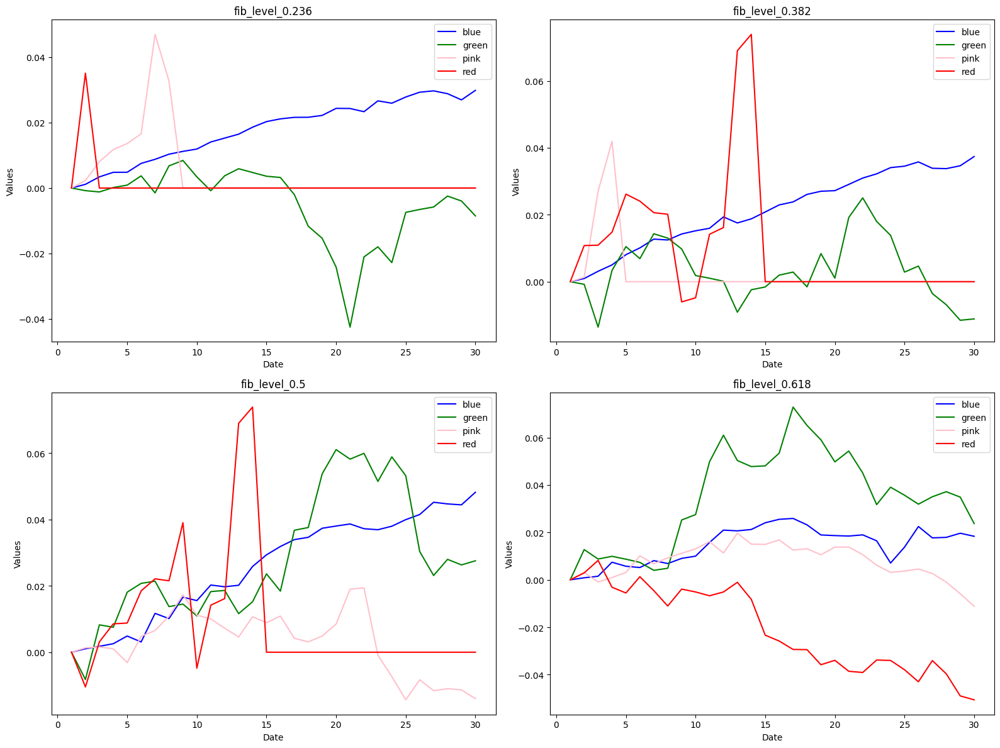

In [19]:
num_plots = len(fib_df)
num_rows = num_plots // 2 + num_plots % 2
num_cols = 2

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(16, 12))


# Plot each pair of DataFrames
for i, (key, df) in enumerate(fib_df.items()):
    row = i // 2
    col = i % 2
    ax = axs[row, col] if num_rows > 1 else axs[col]
    
    # Plot each column except the datetime index
    for column in df.columns:
        ax.plot(df.index, df[column], color = column, label=column)
    
    ax.set_title(key)
    ax.set_xlabel('Date')
    ax.set_ylabel('Values')
    ax.legend()

# Adjust layout and display
plt.tight_layout()
plt.show()

Fib 0.236 - LONG Bearish and Bullish low var  
Fib 0.382 - LONG Bullish low var  
Fib 0.5 - LONG Bullish high var and low var and LONG bearish high var  
Fib 0.618 - LONG Bullish high var and SHORT Bearish high var  

LONG Bearish low var - Fib 0.236  
LONG Bearish high var -  Fib 0.5, Fib 0.382  
LONG Bullish low var -  Fib 0.382, Fib 0.5, 0.236  
LONG Bullish high var -  Fib 0.5, Fib 0.618  
SHORT Bearish low var - Fib 0.5   
SHORT Bearish high var - Fib 0.618  
SHORT Bullish low var -   
SHORT Bullish high var -  


## Price trends for MACD Indicator

/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_52248/242935777.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_52248/242935777.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'].iloc[0] = 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_52248/242935777.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer

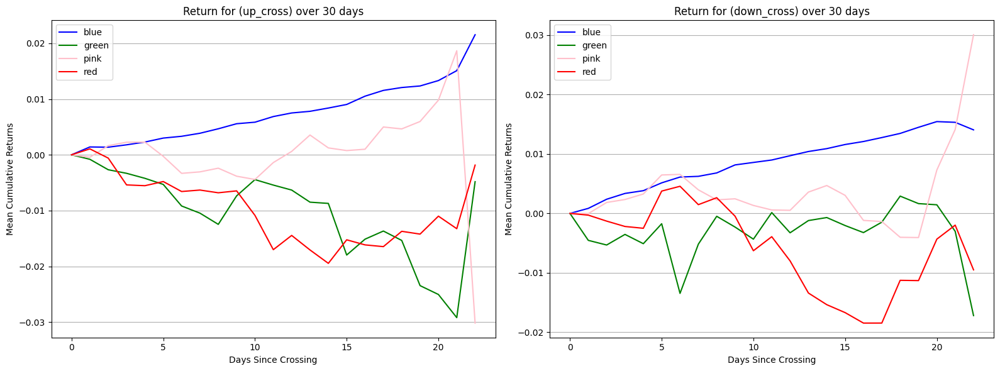

In [20]:
import matplotlib.pyplot as plt

regimes = ['blue', 'green', 'pink', 'red']
macd_crosses = ['up_cross', 'down_cross']
mean_returns = {cross: {} for cross in macd_crosses}
rows = len(macd_crosses)//2+len(macd_crosses)%2

# Define up and down crossovers
data['up_cross'] = (data['MACD_histogram'] > 0) & (data['MACD_histogram'].shift(1) < 0)
data['down_cross'] = (data['MACD_histogram'] < 0) & (data['MACD_histogram'].shift(1) > 0)

for cross in macd_crosses:
    crossings = data[data[cross]]

    for regime in regimes:
        returns = []

        for date in crossings.index:
            next_30_days = data.loc[date:date + pd.Timedelta(days=30)]
            
            next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
            next_30_days['returns'].iloc[0] = 1
            next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1

            current_regime = next_30_days['regime'].iloc[0]
            
            if current_regime == regime:
                daily_returns = []
                for next_date, row in next_30_days.iterrows():
                    if row['regime'] != regime:
                        break
                    daily_returns.append(row['cumulative_returns'])
                returns.append(daily_returns)

        if returns:
            max_length = max(len(r) for r in returns)
            returns_padded = [r + [np.nan]*(max_length - len(r)) for r in returns]
        else:
            returns_padded = []

        returns_array = np.array(returns_padded)
        mean_returns[cross][regime] = np.nanmean(returns_array, axis=0)

fig, axs = plt.subplots(rows, 2, figsize=(16, 6))

# Flatten the axes array for easy iteration
axs = axs.flatten()

for ax, cross in zip(axs, macd_crosses):
    for regime, returns in mean_returns[cross].items():
        if isinstance(returns, np.ndarray):
            ax.plot(range(len(returns)), returns, color=regime, label=regime)
        else:
            ax.plot(0, returns, color=regime, label=regime)
    ax.set_title(f'Return for ({cross}) over 30 days')
    ax.set_xlabel('Days Since Crossing')
    ax.set_ylabel('Mean Cumulative Returns')
    ax.legend()
    ax.grid(axis='y')

plt.tight_layout()
plt.show()

In [21]:
crosses = ['up', 'down']
regimes = ['blue', 'green', 'pink', 'red']

result = {}
regime_count = {}
for cross in crosses:
    regime_count[cross] = {}
    result[cross] = {}
    for regime in regimes:
        result[cross][regime] = {}
        regime_count[cross][regime] = {}
        for i in range(1, 31):
            regime_count[cross][regime][i] = 0
            result[cross][regime][i] = 0
    hold = 1
    enter = hold
    current = 0
    entered = False
    timeframe = 0
    trades = 0
    current_regime = ""

    for index, row in data.iterrows():
        if not entered:
            if row[f'{cross}_cross']:
                entered = True
                enter = row['Close']
                current_regime = row['regime']
        if entered:
            timeframe += 1
            if timeframe == 30 or row['regime'] != current_regime:
                result[cross][current_regime][timeframe] += ((row['Close'] / enter) - 1)
                regime_count[cross][current_regime][timeframe] += 1
                timeframe = 0
                entered = False
            else:
                result[cross][current_regime][timeframe] += ((row['Close'] / enter) - 1)
                regime_count[cross][current_regime][timeframe] += 1

for cross in crosses:
    for regime in regimes:
        for i in result[cross][regime]:
            if regime_count[cross][regime][i] > 0:
                result[cross][regime][i] /= regime_count[cross][regime][i]


print(result)

{'up': {'blue': {1: 0.0, 2: 0.0012606529663755494, 3: 0.001360255821453211, 4: 0.001747611247187142, 5: 0.0025499221211758376, 6: 0.003196362640123362, 7: 0.003829975273212152, 8: 0.0038994041712346306, 9: 0.0050943241147156865, 10: 0.006077193029392669, 11: 0.006536315590684295, 12: 0.00781603736854755, 13: 0.008161773028534085, 14: 0.008538093662143845, 15: 0.009018482335967411, 16: 0.010225360594781987, 17: 0.012024054907853176, 18: 0.01341729206238806, 19: 0.014510485008046189, 20: 0.014111831257204447, 21: 0.014928484867655568, 22: 0.015812182798010155, 23: 0.015692571939414545, 24: 0.01707581612839807, 25: 0.01810092368194135, 26: 0.01864817150910211, 27: 0.01887065194315517, 28: 0.01922787083620276, 29: 0.020967123925689692, 30: 0.021505104730627413}, 'green': {1: 0.0, 2: -0.0009600546207185234, 3: -0.006237627433409756, 4: -0.00191545892449345, 5: -0.0007620209146171111, 6: 0.0024809866187034983, 7: -0.004812182761976857, 8: -0.008721040102956122, 9: -0.011553791206465614, 10: 

creating the dataframe for returns from MACD strategy

In [22]:
macd_df = {macd: pd.DataFrame(result[macd]) for macd in result}

macd_df["up"].tail()

,blue,green,pink,red
26,0.018648,-0.017905,0.002361,-0.035384
27,0.018871,-0.033300,0.000634,-0.037105
28,0.019228,-0.035521,-0.002191,-0.036035
29,0.020967,-0.027905,-0.001818,-0.028911
30,0.021505,-0.030733,-0.004329,-0.032151


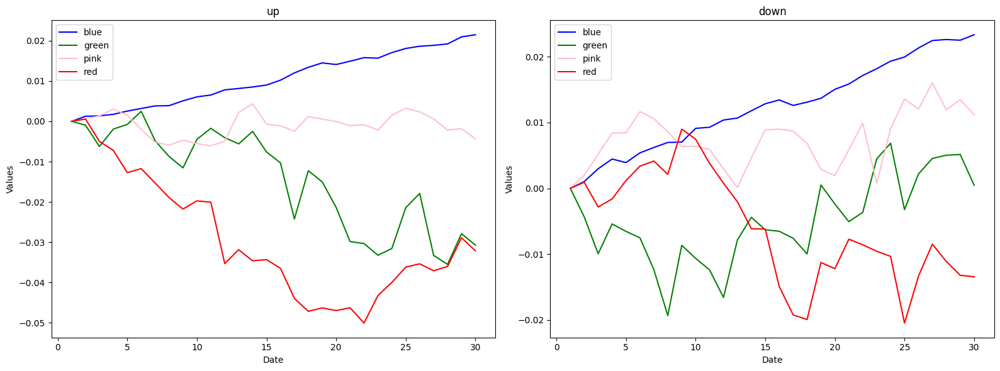

In [23]:
num_plots = len(macd_df)
num_rows = num_plots // 2 + num_plots % 2
num_cols = 2

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(16, 6))


# Plot each pair of DataFrames
for i, (key, df) in enumerate(macd_df.items()):
    row = i // 2
    col = i % 2
    ax = axs[row, col] if num_rows > 1 else axs[col]
    
    # Plot each column except the datetime index
    for column in df.columns:
        ax.plot(df.index, df[column], color = column, label=column)
    
    ax.set_title(key)
    ax.set_xlabel('Date')
    ax.set_ylabel('Values')
    ax.legend()

# Adjust layout and display
plt.tight_layout()
plt.show()

MACD Up crossover - LONG Bullish low var
MACD Down crossover - LONG Bullish low var, SHORT 

Up cross - SHORT Bullish and bearish high var

## Price trends for RSI

/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_52248/1840622678.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_52248/1840622678.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'].iloc[0] = 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_52248/1840622678.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_inde

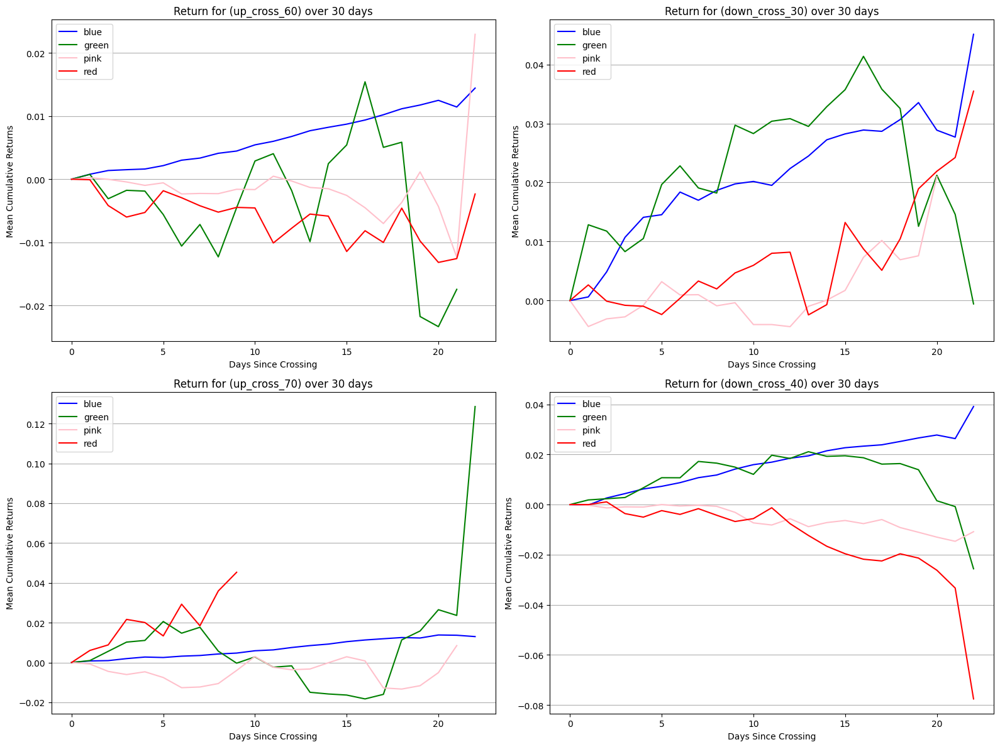

In [24]:
import matplotlib.pyplot as plt

regimes = ['blue', 'green', 'pink', 'red']
rsi_crosses = ['up_cross_60', 'down_cross_30', 'up_cross_70', 'down_cross_40']
rows = len(rsi_crosses)//2+len(rsi_crosses)%2
mean_returns = {cross: {} for cross in rsi_crosses}

# Define up and down crossovers
data['up_cross_60'] = (data['RSI'] > 60) & (data['RSI'].shift(1) < 60)
data['down_cross_30'] = (data['RSI'] < 30) & (data['RSI'].shift(1) > 30)
data['up_cross_70'] = (data['RSI'] > 70) & (data['RSI'].shift(1) < 70)
data['down_cross_40'] = (data['RSI'] < 40) & (data['RSI'].shift(1) > 40)

for cross in rsi_crosses:
    crossings = data[data[cross]]

    for regime in regimes:
        returns = []

        for date in crossings.index:
            next_30_days = data.loc[date:date + pd.Timedelta(days=30)]
            
            next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
            next_30_days['returns'].iloc[0] = 1
            next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1

            current_regime = next_30_days['regime'].iloc[0]
            
            if current_regime == regime:
                daily_returns = []
                for next_date, row in next_30_days.iterrows():
                    if row['regime'] != regime:
                        break
                    daily_returns.append(row['cumulative_returns'])
                returns.append(daily_returns)

        if returns:
            max_length = max(len(r) for r in returns)
            returns_padded = [r + [np.nan]*(max_length - len(r)) for r in returns]
        else:
            returns_padded = []

        returns_array = np.array(returns_padded)
        mean_returns[cross][regime] = np.nanmean(returns_array, axis=0)

fig, axs = plt.subplots(rows, 2, figsize=(16, 12))

# Flatten the axes array for easy iteration
axs = axs.flatten()

for ax, cross in zip(axs, rsi_crosses):
    for regime, returns in mean_returns[cross].items():
        if isinstance(returns, np.ndarray):
            ax.plot(range(len(returns)), returns, color=regime, label=regime)
        else:
            ax.plot(0, returns, color=regime, label=regime)
    ax.set_title(f'Return for ({cross}) over 30 days')
    ax.set_xlabel('Days Since Crossing')
    ax.set_ylabel('Mean Cumulative Returns')
    ax.legend()
    ax.grid(axis='y')

plt.tight_layout()
plt.show()

In [25]:
crosses = ['up_cross_60', 'down_cross_30', 'up_cross_70', 'down_cross_40']
regimes = ['blue', 'green', 'pink', 'red']

result = {}
regime_count = {}
for cross in crosses:
    regime_count[cross] = {}
    result[cross] = {}
    for regime in regimes:
        result[cross][regime] = {}
        regime_count[cross][regime] = {}
        for i in range(1, 31):
            regime_count[cross][regime][i] = 0
            result[cross][regime][i] = 0
    hold = 1
    enter = hold
    current = 0
    entered = False
    timeframe = 0
    trades = 0
    current_regime = ""

    for index, row in data.iterrows():
        if not entered:
            if row[f'{cross}']:
                entered = True
                enter = row['Close']
                current_regime = row['regime']
        if entered:
            timeframe += 1
            if timeframe == 30 or row['regime'] != current_regime:
                result[cross][current_regime][timeframe] += ((row['Close'] / enter) - 1)
                regime_count[cross][current_regime][timeframe] += 1
                timeframe = 0
                entered = False
            else:
                result[cross][current_regime][timeframe] += ((row['Close'] / enter) - 1)
                regime_count[cross][current_regime][timeframe] += 1

for cross in crosses:
    for regime in regimes:
        for i in result[cross][regime]:
            if regime_count[cross][regime][i] > 0:
                result[cross][regime][i] /= regime_count[cross][regime][i]


print(result)


{'up_cross_60': {'blue': {1: 0.0, 2: 0.0011147367623320981, 3: 0.0014872040583177638, 4: 0.0014403362775177008, 5: 0.0015188583612898792, 6: 0.00329644874854215, 7: 0.0038689460986956886, 8: 0.004728145344648026, 9: 0.005263820687899725, 10: 0.005082414160292757, 11: 0.006710173835929088, 12: 0.006580700070386614, 13: 0.00669961931905894, 14: 0.006762437362790007, 15: 0.007345580067832689, 16: 0.007626250728463886, 17: 0.009340611326697092, 18: 0.01017013429001484, 19: 0.011436224851310338, 20: 0.0117721330187208, 21: 0.01294709057227041, 22: 0.013668136197482939, 23: 0.01441667768158429, 24: 0.015576711700881934, 25: 0.014950327365997669, 26: 0.015086901323311233, 27: 0.015270807008808696, 28: 0.015809265668038405, 29: 0.016762626031844266, 30: 0.016621443674708223}, 'green': {1: 0.0, 2: 0.0015022465353750545, 3: -0.002845439977179711, 4: -0.0008373264361490165, 5: -2.5245176459534613e-05, 6: -0.0019160611874586603, 7: -0.006113247656930316, 8: -0.008497400955845317, 9: -0.00932829310

In [26]:
rsi_df = {rsi: pd.DataFrame(result[rsi]) for rsi in result}

rsi_df["up_cross_60"].tail()

,blue,green,pink,red
26,0.015087,0.009280,0.012935,-0.031512
27,0.015271,-0.010929,0.015744,-0.038876
28,0.015809,0.020796,0.011967,-0.029419
29,0.016763,0.028356,0.004314,-0.026730
30,0.016621,0.020471,0.003497,-0.031905


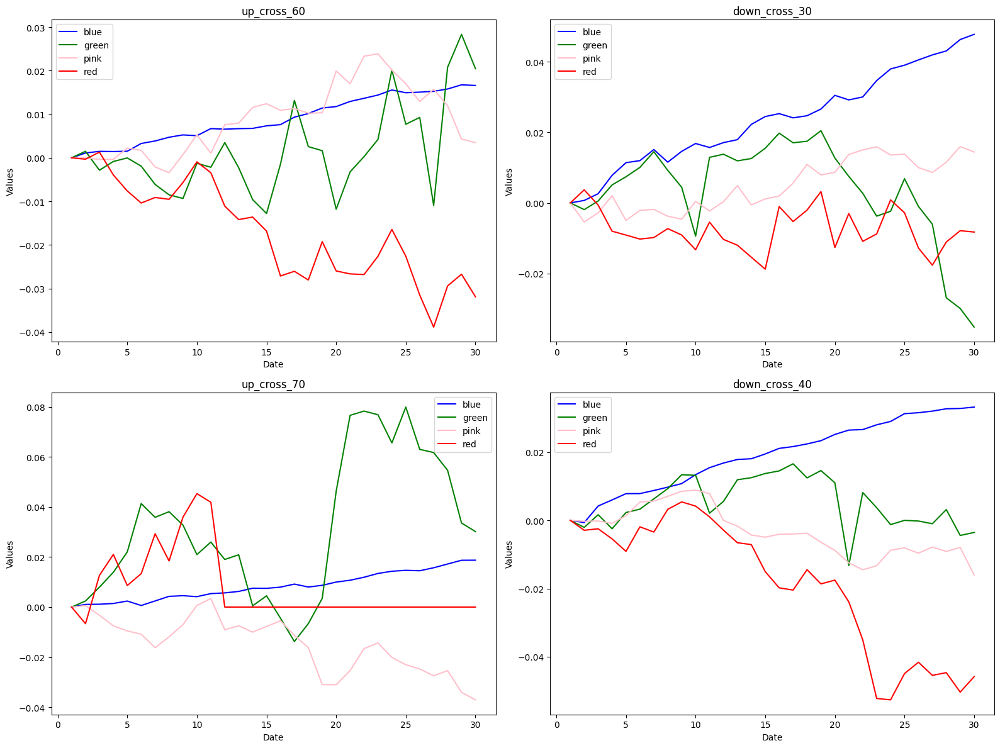

In [27]:
num_plots = len(rsi_df)
num_rows = num_plots // 2 + num_plots % 2
num_cols = 2

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(16, 12))


# Plot each pair of DataFrames
for i, (key, df) in enumerate(rsi_df.items()):
    row = i // 2
    col = i % 2
    ax = axs[row, col] if num_rows > 1 else axs[col]
    
    # Plot each column except the datetime index
    for column in df.columns:
        ax.plot(df.index, df[column], color = column, label=column)
    
    ax.set_title(key)
    ax.set_xlabel('Date')
    ax.set_ylabel('Values')
    ax.legend()

# Adjust layout and display
plt.tight_layout()
plt.show()

RSI Up 60 - LONG bullish low var SHORT bearish high var  
RSI Down 30 - LONG Bullish high and low var LONG bearish low var
RSI Down 40 - SHORT Bearish high var  

SHORT Bearish low var -  
SHORT Bearish high var - RSI 40, 60  
SHORT Bullish low var -  
SHORT Bullish high var - RSI 60 
LONG Bearish low var - RSI 30?  
LONG Bearish high var - RSI 30, 70  
LONG Bullihs low var - All, especially RSI 30 and 40  
LONG Bullish high var - RSI 30  

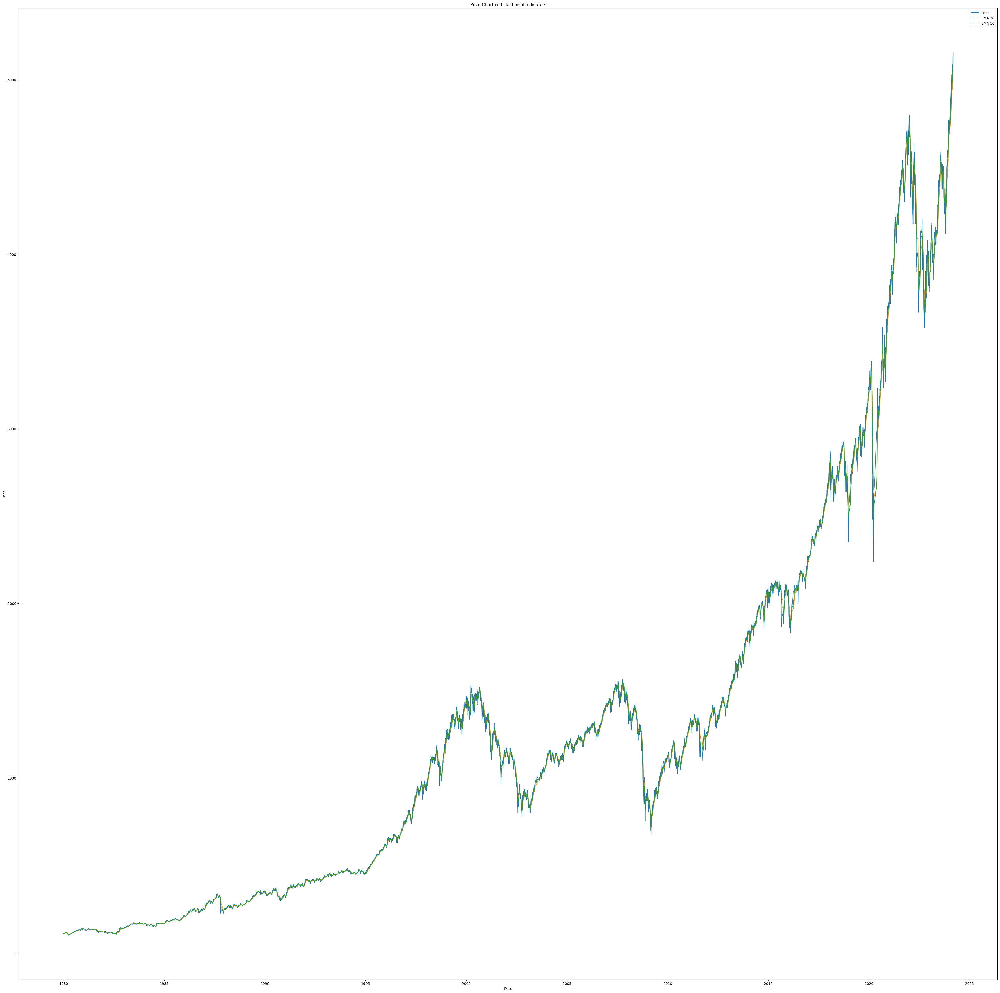

In [28]:
import matplotlib.pyplot as plt

# Set the figsize
fig, ax = plt.subplots(figsize=(50, 50))

# Plot the price chart
ax.plot(data.index, data['Close'], label='Price')

# Plot the technical indicators
ax.plot(data.index, data['ema_20'], label='EMA 20')
ax.plot(data.index, data['ema_10'], label='EMA 10')
# ax.plot(data.index, data['upper_band_1sd'], label='Upper Band 1SD')
# ax.plot(data.index, data['lower_band_1sd'], label='Lower Band 1SD')
# ax.plot(data.index, data['upper_band_1.5sd'], label='Upper Band 1.5SD')
# ax.plot(data.index, data['lower_band_1.5sd'], label='Lower Band 1.5SD')
# ax.plot(data.index, data['upper_band_2sd'], label='Upper Band 2SD')
# ax.plot(data.index, data['lower_band_2sd'], label='Lower Band 2SD')
# ax.plot(data.index, data['fib_level_0.236'], label='Fib Level 0.236')
# ax.plot(data.index, data['fib_level_0.382'], label='Fib Level 0.382')
# ax.plot(data.index, data['fib_level_0.5'], label='Fib Level 0.5')
# ax.plot(data.index, data['fib_level_0.618'], label='Fib Level 0.618')

# Set the plot title and labels
ax.set_title('Price Chart with Technical Indicators')
ax.set_xlabel('Date')
ax.set_ylabel('Price')

# Add a legend
ax.legend()

# Display the plot
plt.show()


In [29]:
print(data.head())

           regime    Volume    Open    High     Low   Close      ema_20  \
Date                                                                      
1979-12-26   blue  24960000  107.78  107.78  107.78  107.78  107.780000   
1979-12-27   blue  31410000  107.96  107.96  107.96  107.96  107.797143   
1979-12-28   blue  34430000  107.84  107.84  107.84  107.84  107.801224   
1979-12-31   blue  31530000  107.94  107.94  107.94  107.94  107.814441   
1980-01-02   blue  40610000  105.76  105.76  105.76  105.76  107.618780   

                ema_10  stddev_20  upper_band_1sd  ...  cross_fib_level_0.236  \
Date                                               ...                          
1979-12-26  107.780000        NaN             NaN  ...                  False   
1979-12-27  107.812727   0.127279      107.924422  ...                  False   
1979-12-28  107.817686   0.092545      107.893770  ...                  False   
1979-12-31  107.839925   0.097630      107.912072  ...               

blue regime buy when down_cross30
green regime buy when up_cross70
pink regime sell when up_cross70
red regime sell when lower_band_2nd

long_exit_condition
Green - down cross 30 

short_exit_condition
Red - up cross 70 4.5%
fib 0.382 fib 0.5 6.5%
pink - lower band 1.5sd
fib 0.2 


In [102]:
data['Signal1'] = 0

def cagr(initial, final, periods):
    return ((final / initial) ** (1/ periods)) - 1

# Define conditions for going long
def long_condition(row):
    return (
        ((row['cross_fib_level_0.5']) and row['regime'] == 'blue') or
        ((row['up_cross_70']) and row['regime'] == 'green')
    )

def long_exit_condition(row):
    return (
        (row['down_cross_30'] and row['regime'] == 'green') 
    )

def short_condition(row):
    return (
        ((row['up_cross_70']) and row['regime'] == 'pink') or 
        ((row['cross_lower_band_2sd']) and row['regime'] == 'red')
    )

def short_exit_condition(row):
    return (
        ((row['cross_fib_level_0.382']) and row['regime'] == 'red') or
        ((row['cross_fib_level_0.236']) and row['regime'] == 'pink')
    )

long_entry = 0
long_exit = 0
short_entry = 0
short_exit = 0
# Initialize a variable to keep track of whether we're currently in a trade or not
regime = data.iloc[0]['regime']
in_long = False
in_short = False
capital = 1
current_value = 1
entry_price = 1
buys = 0
sells = 0
data['capital'] = 0
# Iterate over the DataFrame rows
for i in range(len(data)):
    # If we're not currently in a trade and the long conditions are met, enter a long trade
    if (not in_long or not in_long and in_short) and long_condition(data.iloc[i]):
        if not in_long and not in_short:
            print('longing')
        if in_short:
            print('short to long')
        in_short = False
        long_entry += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal1')] = 1
        data.iloc[i, data.columns.get_loc('capital')] = capital
        entry_price = data.iloc[i - 1]['Close']
        current_value = capital
        in_long = True
    # If we're currently in a trade and the exit conditions are met, exit the trade
    elif (in_long and (long_exit_condition(data.iloc[i]))):
        print('exiting long')
        long_exit += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal1')] = 0
        in_long = False
        capital *= data.iloc[i-1]['Close'] / entry_price
        data.iloc[i, data.columns.get_loc('capital')] = capital
    # If we're currently in a trade and no exit condition is met, continue the trade
    elif (not in_short or not in_short and in_long) and short_condition(data.iloc[i]):
        if not in_short and not in_long:
            print('shorting')
        if not in_short and in_long:
            print('long to short')
        in_long = False
        short_entry += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal1')] = -1
        in_short = True
    elif (in_short and (short_exit_condition(data.iloc[i]))):
        print('exiting short')
        short_exit += 1
        regime = data.iloc[i]['regime'] 
        data.iloc[i, data.columns.get_loc('Signal1')] = 0
        in_short = False
    else:
        data.iloc[i, data.columns.get_loc('Signal1')] = data.iloc[i-1, data.columns.get_loc('Signal1')]
        current_value = capital * (data.iloc[i-1]['Close'] / entry_price)

print(long_entry)
print(long_exit)
print(short_entry)
print(short_exit)

signals1 = data['Signal']


longing
exiting long
shorting
short to long
exiting long
longing
exiting long
longing
exiting long
longing
exiting long
longing
long to short
exiting short
shorting
short to long
exiting long
shorting
exiting short
longing
exiting long
shorting
short to long
long to short
exiting short
9
7
6
3


In [81]:
import quantstats as qs
signals1

Date
1979-12-26    0
1979-12-27    0
1979-12-28    0
1979-12-31    0
1980-01-02    0
             ..
2024-03-01    0
2024-03-04    0
2024-03-05    0
2024-03-06    0
2024-03-07    0
Name: Signal, Length: 10657, dtype: int64

Strategy using only bollinger bands ('Signal3')

In [130]:
data['Signal3'] = 0

def cagr(initial, final, periods):
    return ((final / initial) ** (1/ periods)) - 1

# Define conditions for going long
def long_condition(row):
    return (
        ((row['cross_upper_band_2sd']) and row['regime'] == 'blue') or
        ((row['cross_upper_band_1.5sd']) and row['regime'] == 'green')
    )

def long_exit_condition(row):
    return (
        (row['cross_lower_band_2sd'] and row['regime'] == 'green') 
    )

def short_condition(row):
    return (
        ((row['cross_lower_band_2sd']) and row['regime'] == 'pink') or 
        ((row['cross_upper_band_1.5sd']) and row['regime'] == 'red')
    )

def short_exit_condition(row):
    return (
        ((row['cross_upper_band_2sd']) and row['regime'] == 'red') or
        ((row['cross_upper_band_1sd']) and row['regime'] == 'pink')
    )
# Iterate over the DataFrame rows
for i in range(len(data)):
    # If we're not currently in a trade and the long conditions are met, enter a long trade
    if (not in_long or not in_long and in_short) and long_condition(data.iloc[i]):
        if not in_long and not in_short:
            print('longing')
        if in_short:
            print('short to long')
        in_short = False
        long_entry += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal3')] = 1
        data.iloc[i, data.columns.get_loc('capital')] = capital
        entry_price = data.iloc[i - 1]['Close']
        current_value = capital
        in_long = True
    # If we're currently in a trade and the exit conditions are met, exit the trade
    elif (in_long and (long_exit_condition(data.iloc[i]))):
        print('exiting long')
        long_exit += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal3')] = 0
        in_long = False
        capital *= data.iloc[i-1]['Close'] / entry_price
        data.iloc[i, data.columns.get_loc('capital')] = capital
    # If we're currently in a trade and no exit condition is met, continue the trade
    elif (not in_short or not in_short and in_long) and short_condition(data.iloc[i]):
        if not in_short and not in_long:
            print('shorting')
        if not in_short and in_long:
            print('long to short')
        in_long = False
        short_entry += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal3')] = -1
        in_short = True
    elif (in_short and (short_exit_condition(data.iloc[i]))):
        print('exiting short')
        short_exit += 1
        regime = data.iloc[i]['regime'] 
        data.iloc[i, data.columns.get_loc('Signal3')] = 0
        in_short = False
    else:
        data.iloc[i, data.columns.get_loc('Signal3')] = data.iloc[i-1, data.columns.get_loc('Signal3')]
        current_value = capital * (data.iloc[i-1]['Close'] / entry_price)

print(long_entry)
print(long_exit)
print(short_entry)
print(short_exit)

signals3 = data['Signal3']

exiting long
shorting
short to long
long to short
short to long
exiting long
shorting
exiting short
longing
exiting long
longing
exiting long
shorting
exiting short
longing
long to short
short to long
exiting long
longing
exiting long
longing
long to short
exiting short
longing
long to short
exiting short
longing
long to short
exiting short
longing
16
6
12
5


analysis of bollinger band strategy ('Signal3')

In [131]:
data['Daily_Return3'] = 1
data['Strategy_Return3'] = 1
data['Cumulative_Return3'] = 1

data['Daily_Return3'] = data['Close'].pct_change()

# Compute daily returns of your strategy
data['Strategy_Return3'] = data['Daily_Return3'] * data['Signal3']

# Calculate cumulative returns
data['Cumulative_Return3'] = (1 + data['Strategy_Return3']).cumprod() - 1

data['Log_Cumulative_Return3'] = data['Cumulative_Return3'].apply(lambda x: np.log(1 + x))

data['Peak3'] = data['Cumulative_Return3'].cummax()

# Calculate the drawdown as the percentage decline from the peak
data['Drawdown3'] = (data['Peak3'] - data['Cumulative_Return3']) / (1 + data['Peak2'])

# Calculate the maximum drawdown
max_drawdown3 = data['Drawdown3'].max()

volatility3 = data['Strategy_Return3'].std()
# Calculate weekly volatility
weekly_volatility3 = data['Strategy_Return3'].resample('W').std().mean()

# Calculate monthly volatility
monthly_volatility3 = data['Strategy_Return3'].resample('M').std().mean()

annual_volatility3 = data['Strategy_Return3'].std() * (252 ** 0.5)

average_return3 = data['Strategy_Return3'].mean()*252

std_deviation3 = data['Strategy_Return3'].std()
print(std_deviation3)
# Assuming you have a risk-free rate (rf_rate) available
# Calculate the average excess return of your strategy
excess_return3 = average_return3 - 0.04

# Calculate the Sharpe ratio
sharpe_ratio3 = excess_return3 / std_deviation3

print(f"cumulative return: {data.iloc[len(data) - 1]['Cumulative_Return3']}")
print(f"log cumulative return2: {data.iloc[len(data) - 1]['Log_Cumulative_Return3']}")
print(f"maximum drawdown: {max_drawdown3}")
print(f"volatility: {volatility3}")
print(f"weekly volatility: {weekly_volatility3}")
print(f"monthly volatility: {monthly_volatility3}")
print(f"annal volatility: {annual_volatility3}")
print(f"sharpe ratio: {sharpe_ratio3}")

0.00842108949789362
cumulative return: 2.537698584508145
log cumulative return2: 1.2634763983571689
maximum drawdown: 0.23194985573640245
volatility: 0.00842108949789362
weekly volatility: 0.005007292575567456
monthly volatility: 0.005318417199840498
annal volatility: 0.13368065147786581
sharpe ratio: -0.13884936734465822


Strategy 2: combination long and hold ('Signal 2')

In [103]:
data['Signal2'] = 0

def long_condition(row):
    return (
        ((row['down_cross_30']) and row['regime'] == 'blue') or
        ((row['up_cross_70']) and row['regime'] == 'green')
    )

# def long_exit_condition(row):
#     return (
#         (row['down_cross_30'] and row['regime'] == 'green') 
#     )

def short_condition(row):
    return (
        ((row['up_cross_70']) and row['regime'] == 'pink') or 
        ((row['cross_lower_band_2sd']) and row['regime'] == 'red')
    )

# def short_exit_condition(row):
#     return (
#         ((row['cross_fib_level_0.382']) and row['regime'] == 'red') or
#         ((row['cross_fib_level_0.236']) and row['regime'] == 'pink')
#     )

long_entry = 0
long_exit = 0
short_entry = 0
short_exit = 0
# Initialize a variable to keep track of whether we're currently in a trade or not
regime = data.iloc[0]['regime']
in_long = False
in_short = False
capital = 1
current_value = 1
entry_price = 1
buys = 0
sells = 0
data['capital'] = 0
# Iterate over the DataFrame rows
for i in range(len(data)):
    # If we're not currently in a trade and the long conditions are met, enter a long trade
    if not in_long and long_condition(data.iloc[i]):
        in_short = False
        long_entry += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal2')] = 1
        in_long = True
    elif in_long and short_condition(data.iloc[i]):
        in_long = False
        short_entry += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal2')] = 0
        in_short = True
    else:
        data.iloc[i, data.columns.get_loc('Signal2')] = data.iloc[i-1, data.columns.get_loc('Signal2')]

print(long_entry)
print(long_exit)
print(short_entry)
print(short_exit)

signals2 = data['Signal']

5
0
4
0


analysis of strategy 1: combination long short ('Signal1')

In [129]:
data['Daily_Return1'] = 1
data['Strategy_Return1'] = 1
data['Cumulative_Return1'] = 1

data['Daily_Return1'] = data['Close'].pct_change()

# Compute daily returns of your strategy
data['Strategy_Return1'] = data['Daily_Return1'] * data['Signal1']

# Calculate cumulative returns
data['Cumulative_Return1'] = (1 + data['Strategy_Return1']).cumprod() - 1

data['Log_Cumulative_Return1'] = data['Cumulative_Return1'].apply(lambda x: np.log(1 + x))

data['Peak1'] = data['Cumulative_Return2'].cummax()

# Calculate the drawdown as the percentage decline from the peak
data['Drawdown1'] = (data['Peak1'] - data['Cumulative_Return1']) / (1 + data['Peak1'])

# Calculate the maximum drawdown
max_drawdown1 = data['Drawdown1'].max()

volatility1 = data['Strategy_Return1'].std()
# Calculate weekly volatility
weekly_volatility1 = data['Strategy_Return1'].resample('W').std().mean()

# Calculate monthly volatility
monthly_volatility1 = data['Strategy_Return1'].resample('M').std().mean()

annual_volatility1 = data['Strategy_Return1'].std() * (252 ** 0.5)

average_return1 = data['Strategy_Return1'].mean()*252

std_deviation1 = data['Strategy_Return1'].std()
print(std_deviation1)
# Assuming you have a risk-free rate (rf_rate) available
# Calculate the average excess return of your strategy
excess_return1 = average_return1 - 0.04

# Calculate the Sharpe ratio
sharpe_ratio1 = excess_return1 / std_deviation1

print(f"cumulative return: {data.iloc[len(data) - 1]['Cumulative_Return1']}")
print(f"log cumulative return2: {data.iloc[len(data) - 1]['Log_Cumulative_Return1']}")
print(f"maximum drawdown: {max_drawdown1}")
print(f"volatility: {volatility1}")
print(f"weekly volatility: {weekly_volatility1}")
print(f"monthly volatility: {monthly_volatility1}")
print(f"annal volatility: {annual_volatility1}")
print(f"sharpe ratio: {sharpe_ratio1}")

0.008818240612171296
cumulative return: 4.894312221958974
log cumulative return2: 1.7739878557592803
maximum drawdown: 0.8853875693733155
volatility: 0.008818240612171296
weekly volatility: 0.005804589654470735
monthly volatility: 0.0062299544971144765
annal volatility: 0.13998522996561136
sharpe ratio: 1.3347415313634456


Analysis of strategy 2: long and hold ('Signal2')

In [128]:
data['Daily_Return2'] = 1
data['Strategy_Return2'] = 1
data['Cumulative_Return2'] = 1

data['Daily_Return2'] = data['Close'].pct_change()

# Compute daily returns of your strategy
data['Strategy_Return2'] = data['Daily_Return2'] * data['Signal2']

# Calculate cumulative returns
data['Cumulative_Return2'] = (1 + data['Strategy_Return2']).cumprod() - 1

data['Log_Cumulative_Return2'] = data['Cumulative_Return2'].apply(lambda x: np.log(1 + x))

data['Peak2'] = data['Cumulative_Return2'].cummax()

# Calculate the drawdown as the percentage decline from the peak
data['Drawdown2'] = (data['Peak2'] - data['Cumulative_Return2']) / (1 + data['Peak2'])

# Calculate the maximum drawdown
max_drawdown2 = data['Drawdown2'].max()

volatility2 = data['Strategy_Return2'].std()
# Calculate weekly volatility
weekly_volatility2 = data['Strategy_Return2'].resample('W').std().mean()

# Calculate monthly volatility
monthly_volatility2 = data['Strategy_Return2'].resample('M').std().mean()

annual_volatility2 = data['Strategy_Return2'].std() * (252 ** 0.5)

average_return2 = data['Strategy_Return2'].mean()*252

std_deviation2 = data['Strategy_Return2'].std()
print(std_deviation2)
# Assuming you have a risk-free rate (rf_rate) available
# Calculate the average excess return of your strategy
excess_return2 = average_return2 - 0.04

# Calculate the Sharpe ratio
sharpe_ratio2 = excess_return2 / std_deviation2

print(f"cumulative return: {data.iloc[len(data) - 1]['Cumulative_Return2']}")
print(f"log cumulative return2: {data.iloc[len(data) - 1]['Log_Cumulative_Return2']}")
print(f"maximum drawdown: {max_drawdown2}")
print(f"volatility: {volatility2}")
print(f"weekly volatility: {weekly_volatility2}")
print(f"monthly volatility: {monthly_volatility2}")
print(f"annal volatility: {annual_volatility2}")
print(f"sharpe ratio: {sharpe_ratio2}")

0.00885475893048244
cumulative return: 50.42821062017199
log cumulative return2: 3.940186866651354
maximum drawdown: 0.3392495902426059
volatility: 0.00885475893048244
weekly volatility: 0.006347759615681526
monthly volatility: 0.006836335209706761
annal volatility: 0.14056494029690886
sharpe ratio: 7.134877894577284


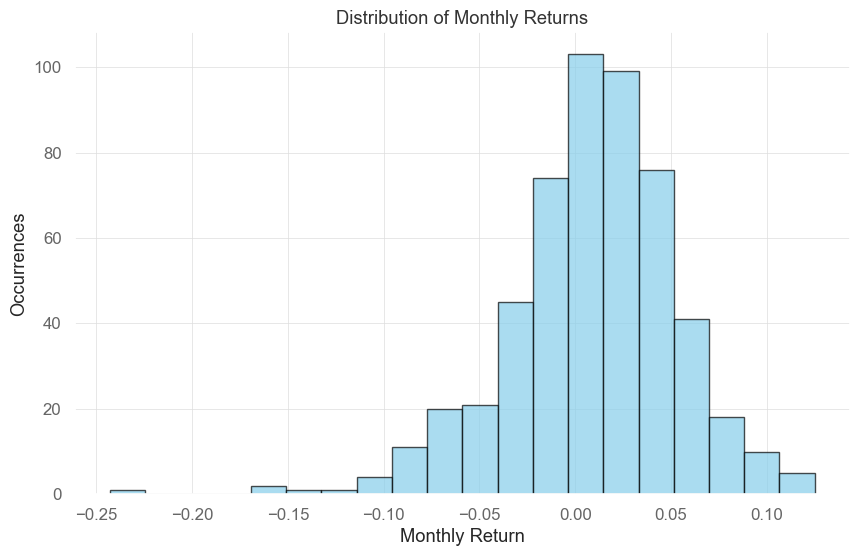

In [123]:
import seaborn as sns

monthly_returns2 = data['Daily_Return2'].resample('M').sum()

# Plotting
plt.figure(figsize=(10, 6))
plt.hist(monthly_returns2, bins=20, color='skyblue', edgecolor='black', alpha=0.7)
plt.title('Distribution of Monthly Returns')
plt.xlabel('Monthly Return')
plt.ylabel('Occurrences')
plt.grid(True)
plt.show()

Strategy using fibonacci only ('Signal4')

In [134]:
data['Signal4'] = 0

def cagr(initial, final, periods):
    return ((final / initial) ** (1/ periods)) - 1

# Define conditions for going long
def long_condition(row):
    return (
        ((row['cross_fib_level_0.5']) and row['regime'] == 'blue') or
        ((row['cross_fib_level_0.618']) and row['regime'] == 'green')
    )

def long_exit_condition(row):
    return (
        (row['cross_fib_level_0.236'] and row['regime'] == 'green') 
    )

def short_condition(row):
    return (
        ((row['cross_fib_level_0.618']) and row['regime'] == 'pink') or 
        ((row['cross_fib_level_0.618']) and row['regime'] == 'red')
    )

def short_exit_condition(row):
    return (
        ((row['cross_fib_level_0.5']) and row['regime'] == 'red') or
        ((row['cross_fib_level_0.382']) and row['regime'] == 'pink')
    )
# Iterate over the DataFrame rows
for i in range(len(data)):
    # If we're not currently in a trade and the long conditions are met, enter a long trade
    if (not in_long or not in_long and in_short) and long_condition(data.iloc[i]):
        if not in_long and not in_short:
            print('longing')
        if in_short:
            print('short to long')
        in_short = False
        long_entry += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal4')] = 1
        data.iloc[i, data.columns.get_loc('capital')] = capital
        entry_price = data.iloc[i - 1]['Close']
        current_value = capital
        in_long = True
    # If we're currently in a trade and the exit conditions are met, exit the trade
    elif (in_long and (long_exit_condition(data.iloc[i]))):
        print('exiting long')
        long_exit += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal4')] = 0
        in_long = False
        capital *= data.iloc[i-1]['Close'] / entry_price
        data.iloc[i, data.columns.get_loc('capital')] = capital
    # If we're currently in a trade and no exit condition is met, continue the trade
    elif (not in_short or not in_short and in_long) and short_condition(data.iloc[i]):
        if not in_short and not in_long:
            print('shorting')
        if not in_short and in_long:
            print('long to short')
        in_long = False
        short_entry += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal4')] = -1
        in_short = True
    elif (in_short and (short_exit_condition(data.iloc[i]))):
        print('exiting short')
        short_exit += 1
        regime = data.iloc[i]['regime'] 
        data.iloc[i, data.columns.get_loc('Signal4')] = 0
        in_short = False
    else:
        data.iloc[i, data.columns.get_loc('Signal4')] = data.iloc[i-1, data.columns.get_loc('Signal4')]
        current_value = capital * (data.iloc[i-1]['Close'] / entry_price)

print(long_entry)
print(long_exit)
print(short_entry)
print(short_exit)

signals4 = data['Signal4']


longing
long to short
exiting short
longing
exiting long
shorting
short to long
long to short
exiting short
longing
long to short
short to long
exiting long
shorting
exiting short
shorting
short to long
exiting long
longing
long to short
short to long
exiting long
shorting
exiting short
longing
exiting long
longing
exiting long
shorting
short to long
exiting long
longing
exiting long
longing
exiting long
longing
long to short
exiting short
43
24
32
15


Analysis of fibonacci only strategy ('Signal4')

In [133]:
data['Daily_Return4'] = 1
data['Strategy_Return4'] = 1
data['Cumulative_Return4'] = 1

data['Daily_Return4'] = data['Close'].pct_change()

# Compute daily returns of your strategy
data['Strategy_Return4'] = data['Daily_Return4'] * data['Signal4']

# Calculate cumulative returns
data['Cumulative_Return4'] = (1 + data['Strategy_Return4']).cumprod() - 1

data['Log_Cumulative_Return4'] = data['Cumulative_Return4'].apply(lambda x: np.log(1 + x))

data['Peak4'] = data['Cumulative_Return4'].cummax()

# Calculate the drawdown as the percentage decline from the peak
data['Drawdown4'] = (data['Peak4'] - data['Cumulative_Return4']) / (1 + data['Peak4'])

# Calculate the maximum drawdown
max_drawdown4 = data['Drawdown4'].max()

volatility4 = data['Strategy_Return4'].std()
# Calculate weekly volatility
weekly_volatility4 = data['Strategy_Return4'].resample('W').std().mean()

# Calculate monthly volatility
monthly_volatility4 = data['Strategy_Return4'].resample('M').std().mean()

annual_volatility4 = data['Strategy_Return4'].std() * (252 ** 0.5)

average_return4 = data['Strategy_Return4'].mean()*252

std_deviation4 = data['Strategy_Return4'].std()
print(std_deviation4)
# Assuming you have a risk-free rate (rf_rate) available
# Calculate the average excess return of your strategy
excess_return4 = average_return4 - 0.04

# Calculate the Sharpe ratio
sharpe_ratio4 = excess_return4 / std_deviation4

print(f"cumulative return: {data.iloc[len(data) - 1]['Cumulative_Return4']}")
print(f"log cumulative return: {data.iloc[len(data) - 1]['Log_Cumulative_Return4']}")
print(f"maximum drawdown: {max_drawdown4}")
print(f"volatility: {volatility4}")
print(f"weekly volatility: {weekly_volatility4}")
print(f"monthly volatility: {monthly_volatility4}")
print(f"annal volatility: {annual_volatility4}")
print(f"sharpe ratio: {sharpe_ratio4}")

0.008776683179737394
cumulative return: 1.9137031724214362
log cumulative return: 1.0694248399976518
maximum drawdown: 0.6117870611640175
volatility: 0.008776683179737394
weekly volatility: 0.005162551079037177
monthly volatility: 0.005545043419915518
annal volatility: 0.1393255261775325
sharpe ratio: -0.5744361838184641


Strategy using MACD only ('Signal5')

In [101]:
data['Signal5'] = 0

def cagr(initial, final, periods):
    return ((final / initial) ** (1/ periods)) - 1

# Define conditions for going long
def long_condition(row):
    return (
        ((row['up_cross']) and row['regime'] == 'blue') or
        ((row['down_cross']) and row['regime'] == 'green')
    )

def long_exit_condition(row):
    return (
        (row['down_cross'] and row['regime'] == 'green') or
        (row['down_cross'] and row['regime'] == 'blue') 
    )

def short_condition(row):
    return (
        ((row['down_cross']) and row['regime'] == 'pink') or 
        ((row['down_cross']) and row['regime'] == 'red')
    )

def short_exit_condition(row):
    return (
        ((row['up_cross']) and row['regime'] == 'red') or
        ((row['up_cross']) and row['regime'] == 'pink')
    )
# Iterate over the DataFrame rows
for i in range(len(data)):
    # If we're not currently in a trade and the long conditions are met, enter a long trade
    if (not in_long or not in_long and in_short) and long_condition(data.iloc[i]):
        if not in_long and not in_short:
            print('longing')
        if in_short:
            print('short to long')
        in_short = False
        long_entry += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal5')] = 1
        data.iloc[i, data.columns.get_loc('capital')] = capital
        entry_price = data.iloc[i - 1]['Close']
        current_value = capital
        in_long = True
    # If we're currently in a trade and the exit conditions are met, exit the trade
    elif (in_long and (long_exit_condition(data.iloc[i]))):
        print('exiting long')
        long_exit += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal5')] = 0
        in_long = False
        capital *= data.iloc[i-1]['Close'] / entry_price
        data.iloc[i, data.columns.get_loc('capital')] = capital
    # If we're currently in a trade and no exit condition is met, continue the trade
    elif (not in_short or not in_short and in_long) and short_condition(data.iloc[i]):
        if not in_short and not in_long:
            print('shorting')
        if not in_short and in_long:
            print('long to short')
        in_long = False
        short_entry += 1
        regime = data.iloc[i]['regime']
        data.iloc[i, data.columns.get_loc('Signal5')] = -1
        in_short = True
    elif (in_short and (short_exit_condition(data.iloc[i]))):
        print('exiting short')
        regime = data.iloc[i]['regime'] 
        data.iloc[i, data.columns.get_loc('Signal5')] = 0
        in_short = False
    else:
        data.iloc[i, data.columns.get_loc('Signal5')] = data.iloc[i-1, data.columns.get_loc('Signal5')]
        current_value = capital * (data.iloc[i-1]['Close'] / entry_price)

print(long_entry)
print(long_exit)
print(short_entry)
print(short_exit)

signals4 = data['Signal4']

False